In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import re

In [ ]:
path = "../data/books_data_t.csv"
df = pd.read_csv("../data/books_data_t.csv")
df.head()

In [ ]:
df.info()

In [ ]:
df.describe()

In [ ]:
df.columns

In [ ]:
df['Titre'].value_counts()

In [ ]:
df.isnull().sum()

In [ ]:
from collections import Counter
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [ ]:
from collections import Counter
import re

# Combine all book descriptions into one text
text = df['Description'].dropna().str.cat(sep=' ')

# Split the text into individual words
words = re.findall(r'\b\w+\b', text)

# Use Counter to count the frequency of each word
word_freq = Counter(words)

# Display the most common words
common_words = word_freq.most_common(10)

print(common_words)

In [ ]:
text_Without_stopwords = []
for word in words:
    print(word)
    if word not in stopwords.words('french'):
        print(word + " ajouté")
        text_Without_stopwords.append(word)

In [ ]:
# Maintenant analyse après avoir enlevé les stopwords
word_freq = Counter(text_Without_stopwords)

# Display the most common words
common_words = word_freq.most_common(10)

print(common_words)

In [ ]:
# Récupérer Les mots les plus fréquents dans les revues ayant obtenues un score >5 (afficher sous forme de WordCloud)

In [21]:
text = df[df['Nb scores'] > 5]['Description'].dropna().str.cat(sep=' ')
words = re.findall(r'\b\w+\b', text)
words = [word.lower() for word in words]
text_Without_stopwords = []
for word in words:
    if word not in stopwords.words('english'):
        print(word + " ajouté")
        text_Without_stopwords.append(word)
word_freq = Counter(text_Without_stopwords)
common_words = word_freq.most_common(10)
print(common_words)

something ajouté
strange ajouté
new ajouté
girls ajouté
town ajouté
briar ajouté
creek ajouté
oregon ajouté
never ajouté
seen ajouté
anything ajouté
like ajouté
supernatural ajouté
grace ajouté
rowan ajouté
kestrel ajouté
jade ajouté
three ajouté
sisters ajouté
move ajouté
dilapidated ajouté
old ajouté
house ajouté
next ajouté
mark ajouté
mary ajouté
lynnette ajouté
carter ajouté
publisher ajouté
gaining ajouté
ability ajouté
speak ajouté
swallowing ajouté
parakeet ajouté
rabbi ajouté
cat ajouté
uses ajouté
newfound ajouté
talent ajouté
tell ajouté
lies ajouté
consequences ajouté
lead ajouté
banned ajouté
contact ajouté
rabbi ajouté
daughter ajouté
education ajouté
torah ajouté
despite ajouté
preference ajouté
kabbalah ajouté
desire ajouté
bar ajouté
mitvah ajouté
mature ajouté
sixth ajouté
book ajouté
kay ajouté
scarpetta ajouté
series ajouté
1 ajouté
bestselling ajouté
author ajouté
patricia ajouté
cornwell ajouté
america ajouté
chilling ajouté
writer ajouté
crime ajouté
fiction ajou

In [22]:
print (common_words)# Enregistrer les mots les plus fréquents dans un fichier avec leur fréquence

with open('most_common_words.txt', 'w') as f:
    for word in common_words:
        f.write(word[0] + " " + str(word[1]) + "\n")

[('new', 5869), ('one', 5096), ('life', 4503), ('book', 4434), ('world', 3852), ('story', 2726), ('first', 2697), ('author', 2637), ('times', 2415), ('novel', 2388)]


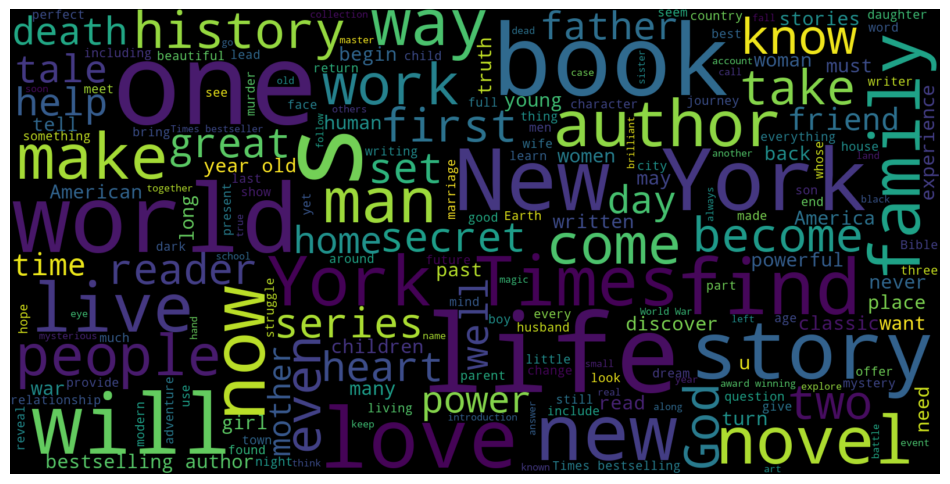

In [25]:
# Afficher les mots les plus fréquents sous forme de WordCloud
from wordcloud import WordCloud
wordcloud = WordCloud(width=1600, height=800, max_font_size=200).generate(text)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [28]:
# Existe-t-il une corrélation entre le prix et la revue (le score de la revue) ?
df.head()

,Titre,Description,Auteurs,Image,Lien Google,Editeur,Date publication,infoLink,Genre,Nb scores
0,Its Only Art If Its Well Hung!,NaN,['Julie Strain'],http://books.google.com/books/content?id=DykPA...,http://books.google.nl/books?id=DykPAAAACAAJ&d...,NaN,1996,http://books.google.nl/books?id=DykPAAAACAAJ&d...,['Comics & Graphic Novels'],NaN
1,Dr. Seuss: American Icon,Philip Nel takes a fascinating look into the k...,['Philip Nel'],http://books.google.com/books/content?id=IjvHQ...,http://books.google.nl/books?id=IjvHQsCn_pgC&p...,A&C Black,01/01/2005,http://books.google.nl/books?id=IjvHQsCn_pgC&d...,['Biography & Autobiography'],NaN
2,Wonderful Worship in Smaller Churches,This resource includes twelve principles in un...,['David R. Ray'],http://books.google.com/books/content?id=2tsDA...,http://books.google.nl/books?id=2tsDAAAACAAJ&d...,NaN,2000,http://books.google.nl/books?id=2tsDAAAACAAJ&d...,['Religion'],NaN
3,Whispers of the Wicked Saints,Julia Thomas finds her life spinning out of co...,['Veronica Haddon'],http://books.google.com/books/content?id=aRSIg...,http://books.google.nl/books?id=aRSIgJlq6JwC&d...,iUniverse,2005-02,http://books.google.nl/books?id=aRSIgJlq6JwC&d...,['Fiction'],NaN
4,"Nation Dance: Religion, Identity and Cultural ...",NaN,['Edward Long'],NaN,http://books.google.nl/books?id=399SPgAACAAJ&d...,NaN,01/03/2003,http://books.google.nl/books?id=399SPgAACAAJ&d...,NaN,NaN


In [31]:
# Distribution des sentiments négatifs, neutres et positifs dans l'ensemble du corpus
df2 = pd.read_csv("../data/Books_rating_t.csv")
df2.head()

,Id,Titre,Prix,User_id,Nom lecteur,revue/utilité,revue/score,revue/heure,revue/résumé,revue/texte
0,1882931173,Its Only Art If Its Well Hung!,NaN,AVCGYZL8FQQTD,"Jim of Oz ""jim-of-oz""",7/7,4.0,940636800,Nice collection of Julie Strain images,This is only for Julie Strain fans. It's a col...
1,0826414346,Dr. Seuss: American Icon,NaN,A30TK6U7DNS82R,Kevin Killian,10/10,5.0,1095724800,Really Enjoyed It,I don't care much for Dr. Seuss but after read...
2,0826414346,Dr. Seuss: American Icon,NaN,A3UH4UZ4RSVO82,John Granger,10/11,5.0,1078790400,Essential for every personal and Public Library,"If people become the books they read and if ""t..."
3,0826414346,Dr. Seuss: American Icon,NaN,A2MVUWT453QH61,"Roy E. Perry ""amateur philosopher""",7/7,4.0,1090713600,Phlip Nel gives silly Seuss a serious treatment,"Theodore Seuss Geisel (1904-1991), aka &quot;D..."
4,0826414346,Dr. Seuss: American Icon,NaN,A22X4XUPKF66MR,"D. H. Richards ""ninthwavestore""",3/3,4.0,1107993600,Good academic overview,Philip Nel - Dr. Seuss: American IconThis is b...


In [32]:
df.head()

,Titre,Description,Auteurs,Image,Lien Google,Editeur,Date publication,infoLink,Genre,Nb scores
0,Its Only Art If Its Well Hung!,NaN,['Julie Strain'],http://books.google.com/books/content?id=DykPA...,http://books.google.nl/books?id=DykPAAAACAAJ&d...,NaN,1996,http://books.google.nl/books?id=DykPAAAACAAJ&d...,['Comics & Graphic Novels'],NaN
1,Dr. Seuss: American Icon,Philip Nel takes a fascinating look into the k...,['Philip Nel'],http://books.google.com/books/content?id=IjvHQ...,http://books.google.nl/books?id=IjvHQsCn_pgC&p...,A&C Black,01/01/2005,http://books.google.nl/books?id=IjvHQsCn_pgC&d...,['Biography & Autobiography'],NaN
2,Wonderful Worship in Smaller Churches,This resource includes twelve principles in un...,['David R. Ray'],http://books.google.com/books/content?id=2tsDA...,http://books.google.nl/books?id=2tsDAAAACAAJ&d...,NaN,2000,http://books.google.nl/books?id=2tsDAAAACAAJ&d...,['Religion'],NaN
3,Whispers of the Wicked Saints,Julia Thomas finds her life spinning out of co...,['Veronica Haddon'],http://books.google.com/books/content?id=aRSIg...,http://books.google.nl/books?id=aRSIgJlq6JwC&d...,iUniverse,2005-02,http://books.google.nl/books?id=aRSIgJlq6JwC&d...,['Fiction'],NaN
4,"Nation Dance: Religion, Identity and Cultural ...",NaN,['Edward Long'],NaN,http://books.google.nl/books?id=399SPgAACAAJ&d...,NaN,01/03/2003,http://books.google.nl/books?id=399SPgAACAAJ&d...,NaN,NaN


In [33]:
# df2 contient les colonnes : Id, Titre, Prix, User_Id, Nom Lecteur, revue/utilité, revue/score, revue/score, revue/résumé, revue/texte
# df1 contient : titre, description, auteurs, image, lien google, editeur, date publication, infolink, genre, Nb scores

In [35]:
df2['revue/score'].value_counts()

5.0    1807343
4.0     585616
3.0     254295
1.0     201688
2.0     151058
Name: revue/score, dtype: int64

In [36]:
# Distribution des sentiments négatifs, neutres et positifs dans l'ensemble du corpus

In [37]:
# Combiner les deux dataframes
df3 = pd.merge(df, df2, on='Titre')
df3.head()

,Titre,Description,Auteurs,Image,Lien Google,Editeur,Date publication,infoLink,Genre,Nb scores,Id,Prix,User_id,Nom lecteur,revue/utilité,revue/score,revue/heure,revue/résumé,revue/texte
0,Its Only Art If Its Well Hung!,NaN,['Julie Strain'],http://books.google.com/books/content?id=DykPA...,http://books.google.nl/books?id=DykPAAAACAAJ&d...,NaN,1996,http://books.google.nl/books?id=DykPAAAACAAJ&d...,['Comics & Graphic Novels'],NaN,1882931173,NaN,AVCGYZL8FQQTD,"Jim of Oz ""jim-of-oz""",7/7,4.0,940636800,Nice collection of Julie Strain images,This is only for Julie Strain fans. It's a col...
1,Dr. Seuss: American Icon,Philip Nel takes a fascinating look into the k...,['Philip Nel'],http://books.google.com/books/content?id=IjvHQ...,http://books.google.nl/books?id=IjvHQsCn_pgC&p...,A&C Black,01/01/2005,http://books.google.nl/books?id=IjvHQsCn_pgC&d...,['Biography & Autobiography'],NaN,0826414346,NaN,A30TK6U7DNS82R,Kevin Killian,10/10,5.0,1095724800,Really Enjoyed It,I don't care much for Dr. Seuss but after read...
2,Dr. Seuss: American Icon,Philip Nel takes a fascinating look into the k...,['Philip Nel'],http://books.google.com/books/content?id=IjvHQ...,http://books.google.nl/books?id=IjvHQsCn_pgC&p...,A&C Black,01/01/2005,http://books.google.nl/books?id=IjvHQsCn_pgC&d...,['Biography & Autobiography'],NaN,0826414346,NaN,A3UH4UZ4RSVO82,John Granger,10/11,5.0,1078790400,Essential for every personal and Public Library,"If people become the books they read and if ""t..."
3,Dr. Seuss: American Icon,Philip Nel takes a fascinating look into the k...,['Philip Nel'],http://books.google.com/books/content?id=IjvHQ...,http://books.google.nl/books?id=IjvHQsCn_pgC&p...,A&C Black,01/01/2005,http://books.google.nl/books?id=IjvHQsCn_pgC&d...,['Biography & Autobiography'],NaN,0826414346,NaN,A2MVUWT453QH61,"Roy E. Perry ""amateur philosopher""",7/7,4.0,1090713600,Phlip Nel gives silly Seuss a serious treatment,"Theodore Seuss Geisel (1904-1991), aka &quot;D..."
4,Dr. Seuss: American Icon,Philip Nel takes a fascinating look into the k...,['Philip Nel'],http://books.google.com/books/content?id=IjvHQ...,http://books.google.nl/books?id=IjvHQsCn_pgC&p...,A&C Black,01/01/2005,http://books.google.nl/books?id=IjvHQsCn_pgC&d...,['Biography & Autobiography'],NaN,0826414346,NaN,A22X4XUPKF66MR,"D. H. Richards ""ninthwavestore""",3/3,4.0,1107993600,Good academic overview,Philip Nel - Dr. Seuss: American IconThis is b...


In [40]:
# importer textblob
from textblob import TextBlob

df3['sentiment_score'] = df3['revue/texte'].apply(lambda x: TextBlob(x).sentiment.polarity if isinstance(x,str) else 0)

df3['sentiment'] = df3['sentiment_score'].apply(lambda x: 'positive' if x > 0 else 'negative' if x < 0 else 'neutral')

sentiment_distribution = df3['sentiment'].value_counts()

KeyboardInterrupt: 

In [ ]:
sentiment_distribution.plot(kind='bar', color='green')

In [ ]:
# Existe-t-il une corrélation entre les auteurs et le commentaire (score).
correration = df3[['Auteurs', 'revue/score']].corr()